<a href="https://colab.research.google.com/github/davidkant/mai/blob/master/tutorial/6_1_Cellular_Automata.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 6.1 Cellular Automata
Composer and computer scientist Carla Scalettie' 1987 piece *sunSurgeAutomata* is based on the concept of *cellular automata*, a simple distributed system in which a grid of cells advance through time according to the values of their neighbors. Artists, scientists, mathematicians have been fascinated by the complex and often unpredictable emergent patterns produced by such systems, and because the bottom-up, decentralized structure is more akin to the kinds of systems found in nature. Scalettie writes that the title *sunSurgeAutomata* "refers to a passage from Lewis Thomas’ book *The Lives of a Cell* where he describes the ‘steady surge of energy pouring out from the sun into the unfillable sink of empty space by way of the earth,’ resulting in the ‘improbable ordered dance’ that we call life on Earth." 


Importantly, distributed sytems offer an alternative approach to designing musical intellignece. Scalletti explains that one of her goals was "to create a computer-generated piece that was not based on a model of ‘instruments’ playing ‘notes’; instead, the structure arises from the self-organizing patterns that emerge when you apply the simple (local) cellular automata rules to pulses or as a signal processing algorithm."

 Listen to [sunSurgeAutomata](https://carlascaletti.com/sunsurgeautomata/).
and read Scaletti's [Mu spi manifesto](https://carlascaletti.com/).

All of the sounds in Scaletti's piece are derived using one-dimensional cellular automata. Let's see if we can reproduce some of them!

## Setup
Install external libraries and import them into your notebook session.

In [0]:
# install external libraries for sound playback
from IPython.display import clear_output
!pip install -q git+https://github.com/davidkant/mai#egg=mai;
!apt-get -qq update
!apt-get -qq install -y libfluidsynth1
clear_output()

In [0]:
import mai

Using TensorFlow backend.


## About Cellular Automata

A cellular automaton is a discrete dynamical system consisting of a set of cells arranged on a grid. Each cell may be in one of two states: either *on* (represented as 1) or *off* (represented as 0). Cells are updated through time, simultaneously, from one generation to the next, according to an *update rule*, which determines the next state of a cell according to its current state and the current states of its neighbors. 

In a one-dimensional cellular automaton, cells are arranged in row, with neigbors to the left and right. The image below represents an update rule — how to update the middle cell from the current generation (top) to next generation (bottom) according to the state of a cell and its neighbors.

![ca rules](https://raw.githubusercontent.com/davidkant/aim80L/master/resources/img/CA-rules.png  =400x)

Update rules are represented as lists of eight numbers, each either a `0` or `1`, since there are eight possible configurations of cell and neighbor states. That means there are `2^8 = 256` possible rules!

The evolution of a 1d CA is visualized by stacking successive generations (rows) on top of one another. The initial generation is the top row, the second generation is the second row, the third generation is the third row... 

![ca rules](https://raw.githubusercontent.com/davidkant/aim80L/master/resources/img/CA-generations.png  =400x)



## Let's generate a CA
Generate a 1d CA using the function `mai.ca.generate()`. It takes arguments that determine the rule set, size, and number of iterations to generate.
* `rule` = the CA rule expressed as a list of 8 values
* `size` = the number of cells (in each generation/row)
* `iters` = the number of generations (columns)

In [0]:
# define a rule
rule = [0,0,0,1,1,1,1,0]

# generate 
rows = mai.ca.generate(rule, size=31, iters=15)

Use `mai.ca.plot()` to plot it.

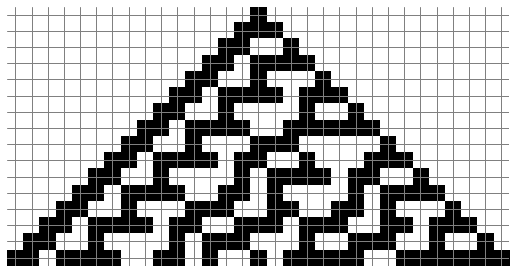

In [0]:
mai.ca.plot(rows)

## Animation
Want to see the CA evolve over time? Animate the CA using `mai.ca.animate()`. Then click the play button to see it.

In [0]:
mai.ca.animate(rows)

## More rules
The fascinating thing about CA is that different rules produce different patterns, and some are really crazy! Try changing the rule. Get anything good? Even though there are `256` possible rules, not all of them are unique. In his book *A New Kind of Science*, Stephen Wolfram shows that there are only 88 rules that generate unique patterns. Wolfram further categorizes the rules into four types, in increasing order of complexity:


1.   Evolve into stable, homogenous states.
2.   Evolve into stable, oscillating states.
3.   Evolve into chaotic patterns.
4.   Evolve into structurs that interact in complex and interesting ways.



In [0]:
# rule 110
rule = [0,1,1,0,1,1,1,0]

# generate 
rows = mai.ca.generate(rule, size=31, iters=15)

# animate
mai.ca.animate(rows)

## Waveform sythnesis
Now how would you turn *that* into sound? Carla Scaletti uses three different strategies in *sunSurgeAutomata*. Let's try one of them for now, which is to treat the CA as a squence of clicks. The function `mai.ca.synth_waveform()` stacks the rows of a CA end to end into one long row, which it then treats as a sound waveform. We'll learn more about waveforms in **Tutorial 7**, but for now, think of it as a digital representation of the physical sound waveform that reaches your ears.

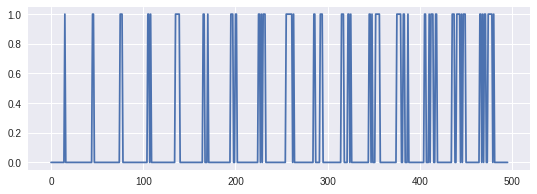

In [0]:
# plot waveform
mai.ca.plot_waveform(rows)

# listen waveform
mai.ca.synth_waveform(rows, stride=5000)

The argument `stride=` determines how much time there is between each cell. Larger values will produce longer files. Smaller values will cross the ryhthm/sound barrier into the percetion of pitch and timbre.

## FFT synthesize
Alex Dupuis' strategy in his audio/visual [Conway Quartet](http://www.alexanderdupuis.com/work/conway.php) is a bit different. Rather than treat the CA data as a sound waveform, Alex interprets the CA data as a spectrogram, in a form of sound synthesis call *iFFT synthesis*. We'll also learn about spectrograms in **Tutorial 7**, but for now, think of it as a picture of the frequency content of sound. We often think of sound as composed of many different frequencies, from low to high — that's why turning up the bass or treble on your stereo accentuates different aspects of sound. Alex interprets the CA as spectral data, kind of like drawing out all of the individual sound frequencies one by one. That's how he gets those crazy sounds. See if you can find any.

iFFT synthesis requires a bit more data, so I'm increasing the `size` and `iters` of our CA.

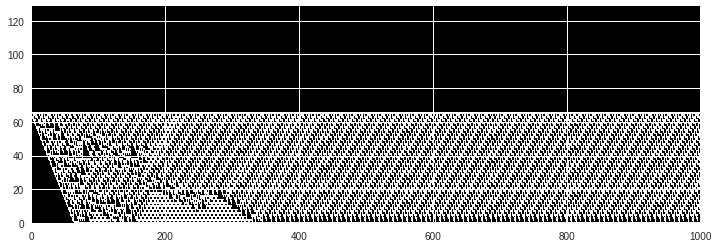

In [0]:
# rule 137
rule = [1,0,0,0,1,0,0,1]

# generate CA
rows = mai.ca.generate(rule, size=129, iters=1000)

# plot iFFT
mai.ca.plot_iFFT(rows)

# list iFFT
mai.ca.synth_iFFT(rows, stride=1)

The synthesis function `mai.ca.synth_iFFT()` takes an argument `stride=` which effectively stretches the CA through time. Try increasing to `stride=5`, how about `stride=50`?

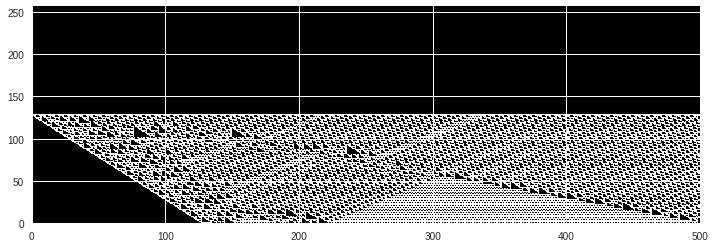

In [0]:
# rule 137
rule = [1,0,0,0,1,0,0,1]

# generate CA
rows = mai.ca.generate(rule, size=257, iters=500)

# plot iFFT
mai.ca.plot_iFFT(rows)

# list iFFT
mai.ca.synth_iFFT(rows, stride=60)

## Enumerating rules
Since there are `255` rules, we can enumerate and refer to them using numbers from `0` to `255`. The function `mai.ca.rule()` converts a rule index to binary list. This is a fun one to stretch out, try `stride=60`.

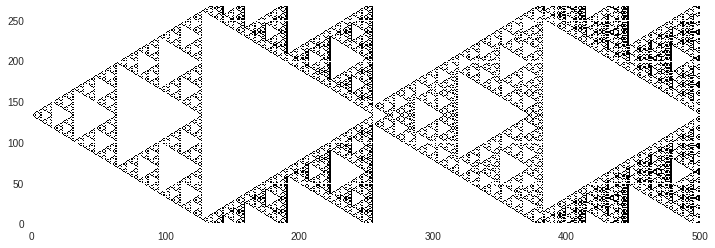

In [0]:
# rule 90
rule = mai.ca.rule(90)

# generate CA
rows = mai.ca.generate(rule, size=267, iters=500)

# plot iFFT
mai.ca.plot_iFFT(rows)

# list iFFT
mai.ca.synth_iFFT(rows, stride=60)

## Start from random
You may have noticed that many CAs display a characteristic triangle shape. This is, in part, because the first generation is initialized to be a row of empty cells with only the middle cell on. You can initialize the first generation to be random instead by setting the keyword argument 
`init_random=True`.

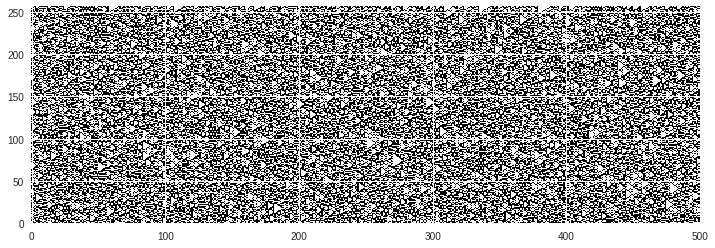

In [0]:
# rule 90
rule = mai.ca.rule(90)

# generate CA
rows = mai.ca.generate(rule, size=257, iters=500, init_random=True)

# plot iFFT
mai.ca.plot_iFFT(rows)

# list iFFT
mai.ca.synth_iFFT(rows, stride=60)

## Start from something
You can also specify a custom initial generation by passing it as an argument `init_pop=`.

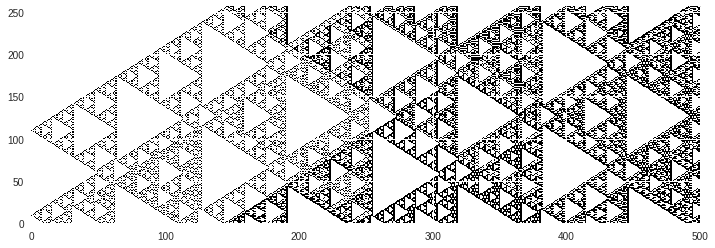

In [0]:
# initial population
gen_zero = [0] * 257
gen_zero[10] = 1
gen_zero[110] = 1

# rule 90
rule = mai.ca.rule(90)

# generate CA
rows = mai.ca.generate(rule, size=257, iters=500, init_pop=gen_zero)

# plot iFFT
mai.ca.plot_iFFT(rows)

# list iFFT
mai.ca.synth_iFFT(rows, stride=60)

## Sonification
Both Carla Scaletti and Alex Dupuis's pieces are examples of an approach to music composition called *sonification* — the mapping of abstract data into sound. The neat thing about sonification is that the auditory system and visual system perceive different kinds of patterns, so looking at and listening to data can reveal different structures. The auditory system, for example, is extremely sensitive to periodicity.

Ever heard the saying "the mapping is the message?" *How* you map data to sound can have more to do with the resulting sound than the data itself. Any sonification is just one way of hearing that data, one of many. That's what makes it fun and creative. Notice how different the CA sounds by changing the stride from a small to large value, or by rendering the sound as a waveform versus iFFT.
